In [19]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from pathlib import Path

# Strava

https://zenodo.org/records/15332147

Data from: Spatio-Temporal Graph Neural Network for Urban Spaces: Interpolating Citywide Traffic Volume

Urban Traffic Volume Dataset – Berlin (Strava) & New York City (Taxi)
Associated paper: Spatio-Temporal Graph Neural Network for Urban Spaces: Interpolating Citywide Traffic Volume
Authors: Silke K. Kaiser, Filipe Rodrigues, Carlos Lima Azevedo, Lynn H. Kaack

Citation Request
If you use this dataset, please cite our paper:

Kaiser, S. K., Rodrigues, F., Azevedo Lima, C., & Kaack, L.H. (2025). Spatio-Temporal Graph Neural Network for Urban Spaces: Interpolating Citywide Traffic Volume. [published on arXiv].

Dataset Overview
This dataset includes street-level traffic volume data for two major urban areas:

Berlin (Strava Cycling Data): Daily bicycle traffic volumes from 2019–2023, aggregated from publicly shared Strava user data.

New York City (Taxi Data): Hourly motorized traffic volumes from Manhattan for January–February 2016, derived from GPS trajectories of yellow taxis.

Both datasets are provided at the street-segment level and come with rich auxiliary features capturing spatial, temporal, infrastructure, and contextual information.

Each city includes:

<City>_data:
Full feature table for each street segment, including traffic volume and auxiliary features.

<City>_graph_geometry:
Geometry for each street segment.

<City>_adjacency_binary:
Binary adjacency matrix.

<City>_adjacency_similarity:
Adjacency matrix weighted by node feature similarity.

<City>_adjacency_distancebird:
Adjacency matrix based on Euclidean (bird’s-eye) distance.

<City>_adjacency_distanceroad:
Adjacency matrix based on real-world road network distance.

<City>_adjacency_distancetime:
Adjacency matrix weighted by estimated travel time over the road network.

Key Features and Methodology
Volume Estimation: Strava volumes are rounded aggregates of bike trips; NYC volumes are computed from reconstructed taxi trajectories.

Filtering: Extreme outliers (e.g., from special events) are filtered per segment to focus on typical traffic conditions.

Auxiliary Features:

Built environment (e.g., speed limits, road types, lane counts)

Points of Interest (e.g., shops, schools, transit stops)

Network connectivity metrics (degree, betweenness, etc.)

Temporal indicators (weekday, holidays, hour, month)

Weather data (sunshine, precipitation, temperature)

Socioeconomic indicators (Berlin only)

Proxy motorized traffic metrics (Berlin only)

See the paper for a complete list of features and detailed methodology.

In [2]:
# I tried to upload files to Google drive and read them, but simple ways don't work for all files
# probably some of them are too large

# https://drive.google.com/drive/u/0/folders/1ATJfOK3sgjXX2sZPbb-kDap-rlJxn59V
# files = {
#     "berlin_adjacency_binary": "1G9lG9ChrSn41LHGoannGYaMxIbsilgUZ",
#     "berlin_adjacency_distancebird": "15UnmVCOLehW69MrC0Ql7K_rlINQ123Nh",
#     "berlin_adjacency_distanceroad": "1ATJfOK3sgjXX2sZPbb-kDap-rlJxn59V",
#     "berlin_adjacency_distancetime": "1ATJfOK3sgjXX2sZPbb-kDap-rlJxn59V",
#     "berlin_adjacency_similarity": "1ATJfOK3sgjXX2sZPbb-kDap-rlJxn59V",
#     "berlin_graph_geometry": "1ATJfOK3sgjXX2sZPbb-kDap-rlJxn59V",
#     "berlin_data": "1ATJfOK3sgjXX2sZPbb-kDap-rlJxn59V"
# }

In [3]:
# In this version, you need to upload all files locally in data folder
base_path = "data"
file_names = [
    "berlin_adjacency_binary",
    "berlin_adjacency_distancebird",
    "berlin_adjacency_distanceroad",
    "berlin_adjacency_distancetime",
    "berlin_adjacency_similarity",
    "berlin_graph_geometry",
    "berlin_data",
]

# Dynamically load each file and assign to a variable
for name in file_names:
    path = os.path.join(base_path, f"{name}.parquet")
    globals()[name] = pd.read_parquet(path)
    print(f"✅ Loaded {name}: shape = {globals()[name].shape}")


✅ Loaded berlin_adjacency_binary: shape = (4958, 4958)
✅ Loaded berlin_adjacency_distancebird: shape = (4958, 4958)
✅ Loaded berlin_adjacency_distanceroad: shape = (4958, 4958)
✅ Loaded berlin_adjacency_distancetime: shape = (4958, 4958)
✅ Loaded berlin_adjacency_similarity: shape = (4958, 4958)
✅ Loaded berlin_graph_geometry: shape = (4958, 4)
✅ Loaded berlin_data: shape = (9053308, 137)


In [4]:
def first_eda(df, df_name, n_columns_display=5):
    print(f"=== {df_name} SUMMARY ===")
    print(f"Shape: {df.shape[0]:,} rows × {df.shape[1]:,} columns")
    print(f"Memory usage: {df.memory_usage(deep=True).sum() / 1e6:.2f} MB")
    
    print("\nFirst 10 column names:")
    print(list(df.columns[:n_columns_display]))
    display(df.iloc[:5, :n_columns_display])


In [5]:
first_eda(berlin_adjacency_binary, "berlin_adjacency_binary")

first_eda(berlin_adjacency_distancebird, "berlin_adjacency_distancebird")

first_eda(berlin_adjacency_distanceroad, "berlin_adjacency_distanceroad")

first_eda(berlin_adjacency_distancetime, "berlin_adjacency_distancetime")

first_eda(berlin_adjacency_similarity, "berlin_adjacency_similarity")

first_eda(berlin_graph_geometry, "berlin_graph_geometry")


=== berlin_adjacency_binary SUMMARY ===
Shape: 4,958 rows × 4,958 columns
Memory usage: 197.02 MB

First 10 column names:
['streetsegment_3572', 'streetsegment_4649', 'streetsegment_478', 'streetsegment_2586', 'streetsegment_2326']


,streetsegment_3572,streetsegment_4649,streetsegment_478,streetsegment_2586,streetsegment_2326
streetsegment_3572,1.0,0.0,0.0,0.0,0.0
streetsegment_4649,0.0,1.0,0.0,0.0,0.0
streetsegment_478,0.0,0.0,1.0,0.0,0.0
streetsegment_2586,0.0,0.0,0.0,1.0,0.0
streetsegment_2326,0.0,0.0,0.0,0.0,1.0


=== berlin_adjacency_distancebird SUMMARY ===
Shape: 4,958 rows × 4,958 columns
Memory usage: 197.02 MB

First 10 column names:
['streetsegment_3572', 'streetsegment_4649', 'streetsegment_478', 'streetsegment_2586', 'streetsegment_2326']


,streetsegment_3572,streetsegment_4649,streetsegment_478,streetsegment_2586,streetsegment_2326
streetsegment_3572,1.000000,0.675594,0.175608,0.101872,0.302013
streetsegment_4649,0.675594,1.000000,0.182123,0.078702,0.372248
streetsegment_478,0.175608,0.182123,1.000000,0.173587,0.407038
streetsegment_2586,0.101872,0.078702,0.173587,1.000000,0.095344
streetsegment_2326,0.302013,0.372248,0.407038,0.095344,1.000000


=== berlin_adjacency_distanceroad SUMMARY ===
Shape: 4,958 rows × 4,958 columns
Memory usage: 197.02 MB

First 10 column names:
['streetsegment_3572', 'streetsegment_4649', 'streetsegment_478', 'streetsegment_2586', 'streetsegment_2326']


,streetsegment_3572,streetsegment_4649,streetsegment_478,streetsegment_2586,streetsegment_2326
streetsegment_3572,1.000000,0.758500,0.004651,0.000051,0.103297
streetsegment_4649,0.758500,1.000000,0.008340,0.000021,0.161142
streetsegment_478,0.004651,0.008340,1.000000,0.004317,0.299610
streetsegment_2586,0.000051,0.000021,0.004317,1.000000,0.000231
streetsegment_2326,0.103297,0.161142,0.299610,0.000231,1.000000


=== berlin_adjacency_distancetime SUMMARY ===
Shape: 4,958 rows × 4,958 columns
Memory usage: 197.02 MB

First 10 column names:
['streetsegment_3572', 'streetsegment_4649', 'streetsegment_478', 'streetsegment_2586', 'streetsegment_2326']


,streetsegment_3572,streetsegment_4649,streetsegment_478,streetsegment_2586,streetsegment_2326
streetsegment_3572,1.000000,6.765493e-01,0.000547,1.786655e-06,0.041971
streetsegment_4649,0.676549,1.000000e+00,0.001220,6.461327e-07,0.069827
streetsegment_478,0.000547,1.220139e-03,1.000000,7.270547e-04,0.167165
streetsegment_2586,0.000002,6.461327e-07,0.000727,1.000000e+00,0.000017
streetsegment_2326,0.041971,6.982677e-02,0.167165,1.747243e-05,1.000000


=== berlin_adjacency_similarity SUMMARY ===
Shape: 4,958 rows × 4,958 columns
Memory usage: 197.02 MB

First 10 column names:
['streetsegment_3572', 'streetsegment_4649', 'streetsegment_478', 'streetsegment_2586', 'streetsegment_2326']


,streetsegment_3572,streetsegment_4649,streetsegment_478,streetsegment_2586,streetsegment_2326
streetsegment_3572,1.000000,0.393956,0.158053,0.460717,0.594547
streetsegment_4649,0.393956,1.000000,0.245534,0.156134,0.379660
streetsegment_478,0.158053,0.245534,1.000000,0.166674,0.332276
streetsegment_2586,0.460717,0.156134,0.166674,1.000000,0.482813
streetsegment_2326,0.594547,0.379660,0.332276,0.482813,1.000000


=== berlin_graph_geometry SUMMARY ===
Shape: 4,958 rows × 4 columns
Memory usage: 2.92 MB

First 10 column names:
['geometry', 'counter_name', 'latitude', 'longitude']


,geometry,counter_name,latitude,longitude
0,LINESTRING (13.354694664935428 52.487495325542...,streetsegment_0,52.486743,13.355350
1,LINESTRING (13.369776955155917 52.460618748885...,streetsegment_1,52.461885,13.369878
2,LINESTRING (13.353876597523895 52.619310421583...,streetsegment_2,52.619820,13.354749
3,LINESTRING (13.35561833290534 52.6203340543749...,streetsegment_3,52.620476,13.357354
4,LINESTRING (13.327470740286854 52.524357729938...,streetsegment_4,52.524039,13.328604


In [6]:
first_eda(berlin_data, "berlin_data", 50)

=== berlin_data SUMMARY ===
Shape: 9,053,308 rows × 137 columns
Memory usage: 20835.54 MB

First 10 column names:
['counter_name', 'date', 'count', 'year', 'latitude', 'longitude', 'geometry', 'socioeconomic_total_population', 'socioeconomic_share_residents_5plus_years_same_address', 'socioeconomic_net_migration_per_100', 'socioeconomic_migration_volume_per_100', 'socioeconomic_share_under_18', 'socioeconomic_share_65_and_older', 'socioeconomic_youth_dependency_ratio', 'socioeconomic_old_age_dependency_ratio', 'socioeconomic_average_age', 'socioeconomic_greying_index', 'socioeconomic_share_with_migration_background', 'socioeconomic_share_foreign_nationals', 'socioeconomic_share_foreign_eu_nationals', 'socioeconomic_share_foreign_non_eu_nationals', 'socioeconomic_gender_distribution', 'socioeconomic_total_fertility_rate', 'socioeconomic_unemployment_rate_age_15_to_65', 'infrastructure_count_education_within0.05km', 'infrastructure_count_hospitals_within0.05km', 'infrastructure_count_sho

,counter_name,date,count,year,latitude,longitude,geometry,socioeconomic_total_population,socioeconomic_share_residents_5plus_years_same_address,socioeconomic_net_migration_per_100,...,infrastructure_count_hospitals_within0.5km,infrastructure_count_shops_within0.5km,infrastructure_count_industry_within0.5km,infrastructure_count_hotels_within0.5km,infrastructure_bicyclelane_type,infrastructure_distance_citycenter_km,infrastructure_distance_citycenter_km_round,infrastructure_type_of_street,infrastructure_number_of_street_lanes,infrastructure_street_smoothness
0,streetsegment_3572,2019-01-01,93.0,year_is_2019,52.529021,13.154621,POINT (13.154621225529942 52.52902107109385),7250.0,67.1,2.2,...,0,3,0,0,no bicycle lane,11.894904,12,residential,infrastructure_number_of_street_lanes_isnan,unclassified
1,streetsegment_3572,2019-01-02,123.0,year_is_2019,52.529021,13.154621,POINT (13.154621225529942 52.52902107109385),7250.0,67.1,2.2,...,0,3,0,0,no bicycle lane,11.894904,12,residential,infrastructure_number_of_street_lanes_isnan,unclassified
2,streetsegment_3572,2019-01-03,151.0,year_is_2019,52.529021,13.154621,POINT (13.154621225529942 52.52902107109385),7250.0,67.1,2.2,...,0,3,0,0,no bicycle lane,11.894904,12,residential,infrastructure_number_of_street_lanes_isnan,unclassified
3,streetsegment_3572,2019-01-04,149.0,year_is_2019,52.529021,13.154621,POINT (13.154621225529942 52.52902107109385),7250.0,67.1,2.2,...,0,3,0,0,no bicycle lane,11.894904,12,residential,infrastructure_number_of_street_lanes_isnan,unclassified
4,streetsegment_3572,2019-01-05,146.0,year_is_2019,52.529021,13.154621,POINT (13.154621225529942 52.52902107109385),7250.0,67.1,2.2,...,0,3,0,0,no bicycle lane,11.894904,12,residential,infrastructure_number_of_street_lanes_isnan,unclassified


In [7]:
berlin_data.columns[:100]

Index(['counter_name', 'date', 'count', 'year', 'latitude', 'longitude',
       'geometry', 'socioeconomic_total_population',
       'socioeconomic_share_residents_5plus_years_same_address',
       'socioeconomic_net_migration_per_100',
       'socioeconomic_migration_volume_per_100',
       'socioeconomic_share_under_18', 'socioeconomic_share_65_and_older',
       'socioeconomic_youth_dependency_ratio',
       'socioeconomic_old_age_dependency_ratio', 'socioeconomic_average_age',
       'socioeconomic_greying_index',
       'socioeconomic_share_with_migration_background',
       'socioeconomic_share_foreign_nationals',
       'socioeconomic_share_foreign_eu_nationals',
       'socioeconomic_share_foreign_non_eu_nationals',
       'socioeconomic_gender_distribution',
       'socioeconomic_total_fertility_rate',
       'socioeconomic_unemployment_rate_age_15_to_65',
       'infrastructure_count_education_within0.05km',
       'infrastructure_count_hospitals_within0.05km',
       'infras

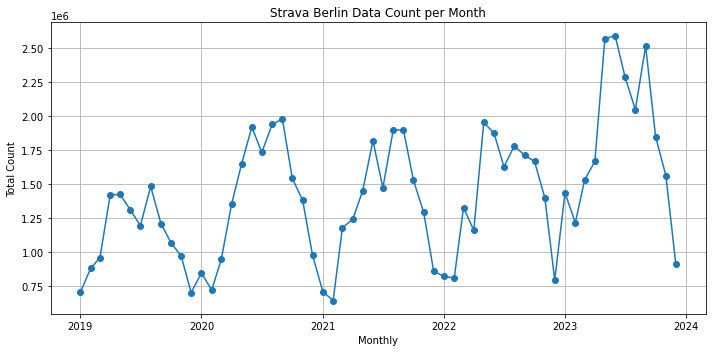

In [8]:
import pandas as pd
import matplotlib.pyplot as plt

def plot_time_aggregation(df, date_column, value_column, aggregation='monthly', title=None):
    """
    Plots aggregated counts over time.
    
    Parameters:
    -----------
    df : pd.DataFrame
        Input DataFrame containing a date column and value column.
    date_column : str
        Name of the column with date or datetime values.
    value_column : str
        Name of the column to aggregate (e.g., 'count').
    aggregation : str, optional
        Aggregation level: 'daily', 'monthly', or 'yearly'. Default is 'monthly'.
    title : str, optional
        Custom plot title. If None, a default title is generated.
    """
    
    # Ensure date column is datetime
    df = df.copy()
    df[date_column] = pd.to_datetime(df[date_column], errors='coerce')
    
    # Choose period based on aggregation
    if aggregation == 'daily':
        df['period'] = df[date_column].dt.to_period('D')
    elif aggregation == 'monthly':
        df['period'] = df[date_column].dt.to_period('M')
    elif aggregation == 'yearly':
        df['period'] = df[date_column].dt.to_period('Y')
    else:
        raise ValueError("aggregation must be one of: 'daily', 'monthly', 'yearly'")
    
    # Aggregate
    agg_df = (
        df.groupby('period')[value_column]
        .sum()
        .reset_index()
    )
    agg_df['period'] = agg_df['period'].dt.to_timestamp()
    
    # Plot
    plt.figure(figsize=(10, 5))
    plt.plot(agg_df['period'], agg_df[value_column], marker='o')
    plt.title(title or f'{value_column.title()} per {aggregation.capitalize()}')
    plt.xlabel(aggregation.capitalize())
    plt.ylabel(f'Total {value_column.title()}')
    plt.grid(True)
    plt.tight_layout()
    plt.show()


plot_time_aggregation(berlin_data, 'date', 'count', aggregation='monthly', title='Strava Berlin Data Count per Month')

# Counting Stations

https://zenodo.org/records/14499984

Data Description
This dataset accompanies the research paper "From Counting Stations to City-Wide Estimates: Data-Driven Bicycle Volume Extrapolation" (Kaiser, Klein and Kaack) and contains the two cleaned datasets used for the daily analysis of bicycle counts (for "all day" and "7-19h" periods).

Contents of the Dataset
Features:

The datasets include all cleaned features obtained after the preprocessing step, resulting in 251 columns.
These features correspond to the original 257 columns described in the paper, minus 10 columns that were dropped during preprocessing. Please refer to the paper for details.
Note on Strava Features: The Strava-related features have been modified, as we are not permitted to publish the original values. These columns are included here solely to provide an impression of their structure and format.
Additional Columns:

Counter: The target feature representing bicycle counts.
Counter Names: Identifies the specific counting station.
Short-Term Counter Indicator: A boolean indicating whether the counter is a short-term counter.
Date: The date corresponding to the recorded data.

In [9]:
name = "prepared_working_data_for_analysis_dailyallday"
path = os.path.join(base_path, f"{name}.csv")
counting_stationas_dailyallday= pd.read_csv(f"data/counting_stations/{name}.csv")
print(f"✅ Loaded {name}: shape = {counting_stationas_dailyallday.shape}")

name = "prepared_working_data_for_analysis_daily719"
path = os.path.join(base_path, f"{name}.csv")
counting_stationas_daily719= pd.read_csv(f"data/counting_stations/{name}.csv")
print(f"✅ Loaded {name}: shape = {counting_stationas_daily719.shape}")


✅ Loaded prepared_working_data_for_analysis_dailyallday: shape = (5965, 251)
✅ Loaded prepared_working_data_for_analysis_daily719: shape = (6100, 251)


In [10]:
first_eda(counting_stationas_dailyallday, "counting_stationas_dailyallday", 50)
first_eda(counting_stationas_daily719, "counting_stationas_daily719", 50)

=== counting_stationas_dailyallday SUMMARY ===
Shape: 5,965 rows × 251 columns
Memory usage: 14.05 MB

First 10 column names:
['date', 'counter_name', 'counter', 'time_month', 'time_day_of_month', 'time_is_weekend', 'time_is_2019_not2022', 'time_is_publicholiday', 'time_weekday', 'holiday_is_schoolholiday', 'bike_sharing_count_destination', 'bike_sharing_count_origin', 'bike_sharing_count_overall', 'bike_sharing_origin_count_within100m', 'bike_sharing_origin_count_within200m', 'bike_sharing_origin_count_within500m', 'bike_sharing_origin_count_within1000m', 'bike_sharing_origin_count_within2000m', 'bike_sharing_origin_count_within5000m', 'bike_sharing_origin_count_within6000m', 'bike_sharing_destination_count_within100m', 'bike_sharing_destination_count_within200m', 'bike_sharing_destination_count_within500m', 'bike_sharing_destination_count_within1000m', 'bike_sharing_destination_count_within2000m', 'bike_sharing_destination_count_within5000m', 'bike_sharing_destination_count_within600

,date,counter_name,counter,time_month,time_day_of_month,time_is_weekend,time_is_2019_not2022,time_is_publicholiday,time_weekday,holiday_is_schoolholiday,...,weather_daily_wspd,weather_daily_wpgt,weather_daily_pres,weather_daily_tsun,socioeconomic_number_of_inhabitants,socioeconomic_share_of_population_with_tenure_exceeding_5_years,socioeconomic_net_migration_rate,socioeconomic_age_specific_demographic_proportions_18,socioeconomic_age_specific_demographic_proportions_65+,socioeconomic_average_age
0,2022-06-17,CW-JU,8250.0,June,17,0,0.0,0,Friday,0,...,9.7,26.6,1020.8,688.0,5157.0,59.7,26.2,13.0,18.3,42.7
1,2022-06-18,CW-JU,4741.0,June,18,1,0.0,0,Saturday,0,...,15.5,38.2,1013.1,853.0,5157.0,59.7,26.2,13.0,18.3,42.7
2,2022-06-19,CW-JU,3805.0,June,19,1,0.0,0,Sunday,0,...,19.1,57.6,1006.1,642.0,5157.0,59.7,26.2,13.0,18.3,42.7
3,2022-06-20,CW-JU,3171.0,June,20,0,0.0,0,Monday,0,...,12.6,43.2,1009.7,194.0,5157.0,59.7,26.2,13.0,18.3,42.7
4,2022-06-21,CW-JU,8917.0,June,21,0,0.0,0,Tuesday,0,...,15.5,38.9,1011.7,700.0,5157.0,59.7,26.2,13.0,18.3,42.7


=== counting_stationas_daily719 SUMMARY ===
Shape: 6,100 rows × 251 columns
Memory usage: 14.32 MB

First 10 column names:
['date', 'counter_name', 'counter', 'time_month', 'time_day_of_month', 'time_is_weekend', 'time_is_2019_not2022', 'time_is_publicholiday', 'time_weekday', 'holiday_is_schoolholiday', 'bike_sharing_count_destination', 'bike_sharing_count_origin', 'bike_sharing_count_overall', 'bike_sharing_origin_count_within100m', 'bike_sharing_origin_count_within200m', 'bike_sharing_origin_count_within500m', 'bike_sharing_origin_count_within1000m', 'bike_sharing_origin_count_within2000m', 'bike_sharing_origin_count_within5000m', 'bike_sharing_origin_count_within6000m', 'bike_sharing_destination_count_within100m', 'bike_sharing_destination_count_within200m', 'bike_sharing_destination_count_within500m', 'bike_sharing_destination_count_within1000m', 'bike_sharing_destination_count_within2000m', 'bike_sharing_destination_count_within5000m', 'bike_sharing_destination_count_within6000m'

,date,counter_name,counter,time_month,time_day_of_month,time_is_weekend,time_is_2019_not2022,time_is_publicholiday,time_weekday,holiday_is_schoolholiday,...,weather_daily_wspd,weather_daily_wpgt,weather_daily_pres,weather_daily_tsun,is_shorttermcounter,socioeconomic_number_of_inhabitants,socioeconomic_share_of_population_with_tenure_exceeding_5_years,socioeconomic_net_migration_rate,socioeconomic_age_specific_demographic_proportions_18,socioeconomic_age_specific_demographic_proportions_65+
0,2022-06-17,CW-JU,6731.0,June,17,0,0.0,0,Friday,0,...,9.7,26.6,1020.8,688.0,False,5157.0,59.7,26.2,13.0,18.3
1,2022-06-18,CW-JU,3690.0,June,18,1,0.0,0,Saturday,0,...,15.5,38.2,1013.1,853.0,False,5157.0,59.7,26.2,13.0,18.3
2,2022-06-19,CW-JU,2987.0,June,19,1,0.0,0,Sunday,0,...,19.1,57.6,1006.1,642.0,False,5157.0,59.7,26.2,13.0,18.3
3,2022-06-20,CW-JU,2580.0,June,20,0,0.0,0,Monday,0,...,12.6,43.2,1009.7,194.0,False,5157.0,59.7,26.2,13.0,18.3
4,2022-06-21,CW-JU,7479.0,June,21,0,0.0,0,Tuesday,0,...,15.5,38.9,1011.7,700.0,False,5157.0,59.7,26.2,13.0,18.3


In [39]:
print(str(counting_stationas_dailyallday.columns))

Index(['date', 'counter_name', 'counter', 'time_month', 'time_day_of_month',
       'time_is_weekend', 'time_is_2019_not2022', 'time_is_publicholiday',
       'time_weekday', 'holiday_is_schoolholiday',
       ...
       'strava_streetvise_daily_streetlevel_total_female_people_count',
       'strava_streetvise_daily_streetlevel_total_18_34_people_count',
       'strava_streetvise_daily_streetlevel_total_35_54_people_count',
       'strava_streetvise_daily_streetlevel_total_55_64_people_count',
       'strava_streetvise_daily_streetlevel_total_65_plus_people_count',
       'strava_streetvise_daily_streetlevel_total_average_speed',
       'strava_streetvise_daily_streetlevel_total_unspecified_people_count',
       'is_shorttermcounter', 'centrality_betweenness', 'year'],
      dtype='object', length=252)


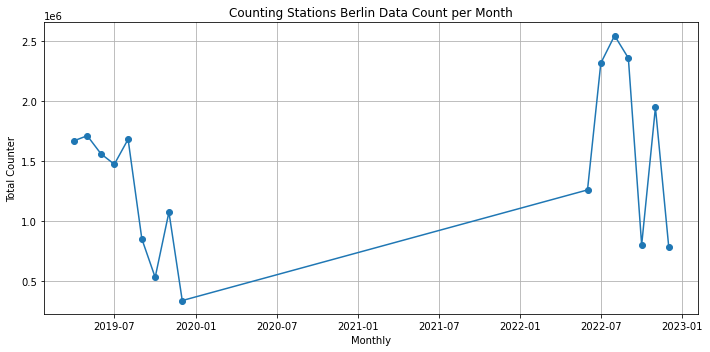

In [11]:
plot_time_aggregation(counting_stationas_dailyallday, 'date', 'counter', aggregation='monthly', title='Counting Stations Berlin Data Count per Month')

In [14]:
counting_stationas_dailyallday['date'] = pd.to_datetime(counting_stationas_dailyallday['date'], errors='coerce')
counting_stationas_dailyallday['year'] = counting_stationas_dailyallday['date'].dt.to_period('Y')

yearly_counts = (
    counting_stationas_dailyallday
    .groupby(['year'])['counter']
    .sum()
    .reset_index()
)

# optional: convert Period to timestamp for plotting
yearly_counts['year'] = yearly_counts['year'].dt.to_timestamp()
yearly_counts


,year,counter
0,2019-01-01,10906716.0
1,2022-01-01,12019186.0


In [23]:
counting_stationas_dailyallday.columns[:100]

Index(['date', 'counter_name', 'counter', 'time_month', 'time_day_of_month',
       'time_is_weekend', 'time_is_2019_not2022', 'time_is_publicholiday',
       'time_weekday', 'holiday_is_schoolholiday',
       'bike_sharing_count_destination', 'bike_sharing_count_origin',
       'bike_sharing_count_overall', 'bike_sharing_origin_count_within100m',
       'bike_sharing_origin_count_within200m',
       'bike_sharing_origin_count_within500m',
       'bike_sharing_origin_count_within1000m',
       'bike_sharing_origin_count_within2000m',
       'bike_sharing_origin_count_within5000m',
       'bike_sharing_origin_count_within6000m',
       'bike_sharing_destination_count_within100m',
       'bike_sharing_destination_count_within200m',
       'bike_sharing_destination_count_within500m',
       'bike_sharing_destination_count_within1000m',
       'bike_sharing_destination_count_within2000m',
       'bike_sharing_destination_count_within5000m',
       'bike_sharing_destination_count_within6000

In [24]:
counting_stationas_dailyallday.counter_name.unique()

array(['CW-JU', 'CW-PRI', 'FK-FRA', 'FK-OBB', 'LI-PUP', 'MH-ALB', 'MI-AL',
       'MI-JAN', 'MI-SAN', 'NK-MAY', 'PA-BER', 'PA-SCH', 'PA-SE',
       'RE-MAR', 'SP-KLO', 'SZ-BRE', 'TK-KAI', 'TS-MAR', 'TS-MON',
       'TS-YOR'], dtype=object)

 # We need to add coordinates to counting stations

In [49]:
import pandas as pd

# ----------------------------------------------------
# 1. Load Standortdaten from gesamtdatei-stundenwerte - official bike counting stations data 2012-2024
# ----------------------------------------------------
xls = pd.ExcelFile('data/counting_stations/gesamtdatei-stundenwerte.xlsx')
df_loc = pd.read_excel(xls, sheet_name='Standortdaten')

# Rename columns to standard English names
df_loc = df_loc.rename(columns={
    "Zählstelle": "zaehlstelle_full",
    "Beschreibung - Fahrtrichtung": "description",
    "Breitengrad": "lat",
    "Längengrad": "lon",
    "Installationsdatum": "installed"
})

# ----------------------------------------------------
# 2. Build SHORT station ID to match counter_name
# ----------------------------------------------------
# Full ID format: "02-MI-JAN-S" → we want "MI-JAN"
# Rule: take the middle 2 tokens: districtcode ("MI") + name ("JAN")

df_loc["counter_name"] = (
    df_loc["zaehlstelle_full"]
        .str.split("-", expand=True)
        .iloc[:, 1] + "-" +
    df_loc["zaehlstelle_full"].str.split("-", expand=True).iloc[:, 2]
)

# Example:
# 02-MI-JAN-N → MI-JAN
# 18-TS-YOR-O → TS-YOR
# 01-CW-PRI   → CW-PRI

# ----------------------------------------------------
# 3. Remove duplicate stations (different directions N/S/W)
# Keep just one row per counter_name
# Coordinates for directions are identical.
# ----------------------------------------------------
df_loc_unique = df_loc.groupby("counter_name").first().reset_index()

# ----------------------------------------------------
# 5. Merge both datasets by counter_name
# ----------------------------------------------------
counting_stationas_dailyallday_loc = counting_stationas_dailyallday.merge(df_loc_unique,
                         on="counter_name",
                         how="left")
counting_stationas_dailyallday_loc.head()
stations_unique = counting_stationas_dailyallday_loc[
    ['counter_name', 'lat', 'lon', 'description']
].drop_duplicates()

stations_unique


,counter_name,lat,lon,description
0,CW-JU,52.513133,13.326845,Straße des 17. Juni West
164,CW-PRI,52.488136,13.333120,Prinzregentenstraße
528,FK-FRA,52.513584,13.474242,Frankfurter Allee Ost
909,FK-OBB,52.501199,13.445060,Oberbaumbrücke Ost
1127,LI-PUP,52.500323,13.474302,Paul-und-Paula-Uferweg
1476,MH-ALB,52.492534,13.558493,Alberichstraße
1706,MI-AL,52.521907,13.417536,Karl-Marx-Allee
1870,MI-JAN,52.513932,13.417835,Jannowitzbrücke Nord
2250,MI-SAN,52.527177,13.372016,Invalidenstraße Ost
2452,NK-MAY,52.492998,13.429682,Maybachufer


# Accidents

In [25]:
csv_dir = Path("data/csv")
csv_files = sorted(csv_dir.glob("*.csv"))

if not csv_files:
    raise FileNotFoundError(f"No CSV files found in {csv_dir.resolve()}")

dfs = []
for fp in csv_files:
    df = pd.read_csv(fp, low_memory=False, delimiter=";")
    df["source_file"] = fp.name 
    dfs.append(df)

accidents = pd.concat(dfs, ignore_index=True)
print(f"Loaded {len(csv_files)} files -> combined shape: {accidents.shape}")

#print all column names
print("Columns:", accidents.columns.tolist())

accidents.head()

Loaded 9 files -> combined shape: (2098019, 35)
Columns: ['OBJECTID', 'UIDENTSTLA', 'ULAND', 'UREGBEZ', 'UKREIS', 'UGEMEINDE', 'UJAHR', 'UMONAT', 'USTUNDE', 'UWOCHENTAG', 'UKATEGORIE', 'UART', 'UTYP1', 'IstRad', 'IstPKW', 'IstFuss', 'IstKrad', 'IstSonstig', 'LICHT', 'STRZUSTAND', 'LINREFX', 'LINREFY', 'XGCSWGS84', 'YGCSWGS84', 'source_file', 'OBJECTID_1', 'ULICHTVERH', 'IstGkfz', 'IstSonstige', 'UIDENTSTLAE', 'IstStrassenzustand', 'OID_', 'PLST', 'FID', 'IstStrasse']


,OBJECTID,UIDENTSTLA,ULAND,UREGBEZ,UKREIS,UGEMEINDE,UJAHR,UMONAT,USTUNDE,UWOCHENTAG,...,OBJECTID_1,ULICHTVERH,IstGkfz,IstSonstige,UIDENTSTLAE,IstStrassenzustand,OID_,PLST,FID,IstStrasse
0,1.0,01170113152013852017,1,0,55,12,2017,1,5,6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2.0,01170113171013912017,1,0,60,53,2017,1,6,6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3.0,01170106105132242017,1,0,61,11,2017,1,18,6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4.0,01170114152013542018,1,0,55,42,2017,1,12,7,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5.0,01170106161013732017,1,0,62,60,2017,1,8,6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [26]:
# drop all accidents that did not involve bicycles (column 'IstRad' != 1)
df_bike = accidents[accidents['IstRad'] == 1].copy()
print(f"Filtered to bicycle accidents -> shape: {df_bike.shape}")

# only keep accidents in Berlin (column 'ULAND' == 11)
df_bike_berlin = df_bike[df_bike['ULAND'] == 11].copy()
print(f"Filtered to bicycle accidents in Berlin -> shape: {df_bike_berlin.shape}")
df_bike_berlin.head()

Filtered to bicycle accidents -> shape: (626844, 35)
Filtered to bicycle accidents in Berlin -> shape: (33181, 35)


,OBJECTID,UIDENTSTLA,ULAND,UREGBEZ,UKREIS,UGEMEINDE,UJAHR,UMONAT,USTUNDE,UWOCHENTAG,...,OBJECTID_1,ULICHTVERH,IstGkfz,IstSonstige,UIDENTSTLAE,IstStrassenzustand,OID_,PLST,FID,IstStrasse
307975,NaN,NaN,11,0,3,3,2018,1,15,4,...,112747.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
308120,NaN,NaN,11,0,3,3,2018,1,11,5,...,112892.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
308130,NaN,NaN,11,0,2,2,2018,1,8,2,...,112902.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
308149,NaN,NaN,11,0,1,1,2018,1,19,4,...,112921.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
308175,NaN,NaN,11,0,9,9,2018,1,18,4,...,112947.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [55]:
import folium
from folium.plugins import HeatMap, MarkerCluster
import pandas as pd

def plot_bike_accidents_with_stations(
    df_acc, 
    df_stations,
    start_date="2024-01-01",
    end_date="2024-12-31",
    outfile="map.html"
):
    # -------------------------------------------------------------
    # 1. Fix coordinates in accidents
    # -------------------------------------------------------------
    for col in ["XGCSWGS84", "YGCSWGS84"]:
        df_acc[col] = (
            df_acc[col]
            .astype(str)
            .str.replace(",", ".", regex=False)
            .astype(float)
        )

    # -------------------------------------------------------------
    # 2. Filter accidents (bikes only, berlin only, date range)
    # -------------------------------------------------------------
    df_acc["date"] = pd.to_datetime(df_acc["UKREIS"], errors="ignore")  # adapt if needed!

    df_bike = df_acc[
        (df_acc["IstRad"] == 1) &
        (df_acc["ULAND"] == 11)
    ].copy()

    df_bike = df_bike.dropna(subset=["XGCSWGS84", "YGCSWGS84"])

    heat_data = df_bike[["YGCSWGS84", "XGCSWGS84"]].values.tolist()

    # -------------------------------------------------------------
    # 3. Filter counting stations by date range
    # -------------------------------------------------------------
    df_stations["date"] = pd.to_datetime(df_stations["date"])
    
    df_period = df_stations[
        (df_stations["date"] >= pd.to_datetime(start_date)) &
        (df_stations["date"] <= pd.to_datetime(end_date))
    ]

    # compute avg daily and total bikes
    grouped = df_period.groupby("counter_name")["counter"]
    df_summary = pd.DataFrame({
        "avg_daily_bikes": grouped.mean(),
        "total_bikes": grouped.sum()
    })

    # add coordinates & descriptions back
    df_summary = df_summary.merge(
        df_stations.drop_duplicates("counter_name")[["counter_name", "lat", "lon", "description"]],
        on="counter_name",
        how="left"
    )

    df_summary = df_summary.dropna(subset=["lat", "lon"])

    # -------------------------------------------------------------
    # 4. Create map
    # -------------------------------------------------------------
    m = folium.Map(location=[52.52, 13.40], zoom_start=11, tiles="CartoDB positron")

    # Heatmap for accidents
    HeatMap(heat_data, radius=12, blur=10, max_zoom=14, min_opacity=0.3).add_to(m)

    # Accident points
    cluster = MarkerCluster(name="Bike accidents").add_to(m)
    for _, row in df_bike.iterrows():
        folium.CircleMarker(
            location=[row["YGCSWGS84"], row["XGCSWGS84"]],
            radius=2,
            color="blue",
            fill=True,
            fill_opacity=0.7
        ).add_to(cluster)

    # Counting stations
    station_layer = folium.FeatureGroup(name="Bike stations").add_to(m)

    for _, row in df_summary.iterrows():
        size = max(3, min(row["avg_daily_bikes"] / 50, 20))

        popup = (
            f"<b>{row['counter_name']}</b><br>"
            f"{row['description']}<br>"
            f"Avg daily bikes: {row['avg_daily_bikes']:.1f}<br>"
            f"Total bikes: {row['total_bikes']}"
        )

        folium.CircleMarker(
            location=[row["lat"], row["lon"]],
            radius=size,
            color="green",
            fill=True,
            fill_opacity=0.8,
            popup=popup
        ).add_to(station_layer)

    folium.LayerControl().add_to(m)
    m.save(outfile)
    return m


plot_bike_accidents_with_stations(
    df_acc=accidents,
    df_stations=counting_stationas_dailyallday_loc,
    start_date="2022-01-01",
    end_date="2023-01-31",
    outfile="bike_counts_and_accidents_map.html"
)
